<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#S.-Figure-1" data-toc-modified-id="S.-Figure-1-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>S. Figure 1</a></span><ul class="toc-item"><li><span><a href="#S.-Figure-1B" data-toc-modified-id="S.-Figure-1B-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>S. Figure 1B</a></span></li><li><span><a href="#S.-Figure-1C" data-toc-modified-id="S.-Figure-1C-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>S. Figure 1C</a></span></li></ul></li><li><span><a href="#S.-Figure-2" data-toc-modified-id="S.-Figure-2-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>S. Figure 2</a></span><ul class="toc-item"><li><span><a href="#S.-Figure-2A" data-toc-modified-id="S.-Figure-2A-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>S. Figure 2A</a></span></li><li><span><a href="#S.-Figure-2B" data-toc-modified-id="S.-Figure-2B-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>S. Figure 2B</a></span><ul class="toc-item"><li><span><a href="#Joint-Model" data-toc-modified-id="Joint-Model-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Joint Model</a></span></li><li><span><a href="#Expression-Model" data-toc-modified-id="Expression-Model-2.2.2"><span class="toc-item-num">2.2.2&nbsp;&nbsp;</span>Expression Model</a></span></li><li><span><a href="#Identity-Model" data-toc-modified-id="Identity-Model-2.2.3"><span class="toc-item-num">2.2.3&nbsp;&nbsp;</span>Identity Model</a></span></li></ul></li></ul></li></ul></div>

In [2]:
import pickle
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# S. Figure 1

In [8]:

with open('SFig1A_with_2_Other_Datasets_Lesioned_models_dict_results.pickle', 'rb') as handle:
    dict_SFig1A = pickle.load(handle)
    
with open('SFig1B_with_2_Other_Datasets_SPLIT_Accuracy_Results.pickle', 'rb') as handle:
    dict_SFig1B = pickle.load(handle)

## S. Figure 1B

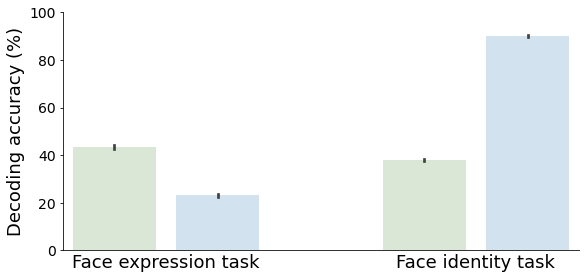

In [5]:


results_dataframe = pd.DataFrame({"Model":np.concatenate([([i]*100) for i in ["exp_model_exp_data",
                                                                          "id_model_exp_data",
                                                                          "",
                                                                          "exp_model_id_data",
                                                                          "id_model_id_data"]], axis=0),
                                                                          "avg_precision_score":0})

results_dataframe.loc[results_dataframe.Model == "exp_model_exp_data",
                  "avg_precision_score"] = dict_SFig1A["precision_score_face_expression_model_face_expression_data"]

results_dataframe.loc[results_dataframe.Model == "exp_model_id_data",
                  "avg_precision_score"] = dict_SFig1A["precision_score_face_expression_model_face_recognition_data"]

results_dataframe.loc[results_dataframe.Model == "id_model_exp_data",
                  "avg_precision_score"] = dict_SFig1A["precision_score_face_recognition_model_face_expression_data"]

results_dataframe.loc[results_dataframe.Model == "id_model_id_data",
                  "avg_precision_score"] = dict_SFig1A["precision_score_face_recognition_model_face_recognition_data"]


x = "Model"
y = "avg_precision_score"


plt.figure(figsize=(8,4))


ax = sns.barplot(data=results_dataframe, x=x, y=y,ci=95,palette=[np.divide([217,234,211],255),
                                                             np.divide([207,226,243],255),
                                                             np.divide([207,226,243],255),
                                                             np.divide([217,234,211],255),
                                                             np.divide([207,226,243],255)])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='x', which='major',length=0)

plt.tight_layout()
plt.yticks(fontsize=14)
plt.ylabel('Decoding accuracy (%)', fontsize=18, color='black')
plt.xlabel('')
plt.xticks([0.5,3.5], ['Face expression task', 'Face identity task'], fontsize=18)

plt.yticks(np.arange(0,1.1,0.2), np.arange(0,101,20), fontsize=14)    

plt.show()

## S. Figure 1C

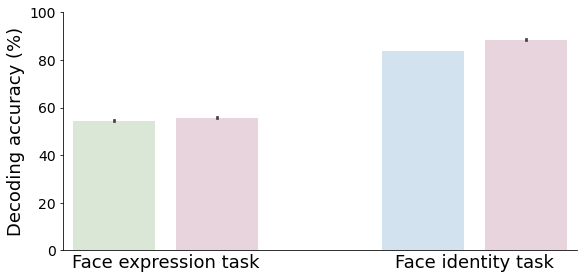

In [9]:
results_dataframe = pd.DataFrame({"Model":np.concatenate((["exp_model_exp_data"]*100,
                                                      ["dual_model_exp_data"]*100,
                                                      [""]*100,
                                                      ["id_model_id_data"]*100,
                                                      ["dual_model_id_data"]*100),
                                                      axis=0),
                                                      "avg_precision_score":0})

results_dataframe.loc[results_dataframe.Model == "exp_model_exp_data",
                  "avg_precision_score"] = [l*100 for l in dict_SFig1B["avg_valid_prec_1_face_expression"]]

results_dataframe.loc[results_dataframe.Model == "dual_model_exp_data",
                  "avg_precision_score"] = [l*100 for l in dict_SFig1B["avg_valid_prec_1_SPLIT_face_expression"]]

results_dataframe.loc[results_dataframe.Model == "id_model_id_data",
                  "avg_precision_score"] = [l*100 for l in dict_SFig1B["avg_valid_prec_1_face_identity"]]

results_dataframe.loc[results_dataframe.Model == "dual_model_id_data",
                  "avg_precision_score"] = [l*100 for l in dict_SFig1B["avg_valid_prec_1_SPLIT_face_identity"]]

results_dataframe["avg_precision_score"] = results_dataframe["avg_precision_score"].astype("float")

x = "Model"
y = "avg_precision_score"


plt.figure(figsize=(8,4))


ax = sns.barplot(data=results_dataframe, x=x, y=y,ci=95,palette=[np.divide([217,234,211],255),
                                                             np.divide([234,209,220],255),
                                                             np.divide([207,226,243],255),
                                                             np.divide([207,226,243],255),
                                                             np.divide([234,209,220],255)])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='x', which='major',length=0)


plt.tight_layout()
plt.yticks(fontsize=14)
plt.ylabel('Decoding accuracy (%)', fontsize=18, color='black')
plt.xlabel('')
plt.xticks([0.5,3.5], ['Face expression task', 'Face identity task'], fontsize=18)

plt.yticks(np.arange(0,110,20), np.arange(0,101,20), fontsize=14)    

plt.show()



# S. Figure 2

In [11]:
with open('SFig2B_SPLIT_Layer_Names_and_Activations.pickle', 'rb') as handle:
    dict_SFig2B_SPLIT_Layer_Names_and_Activations = pickle.load(handle)
    
with open('SFig2B_exp_Layer_Names_and_Activations.pickle', 'rb') as handle:
    dict_SFig2B_exp_Layer_Names_and_Activations = pickle.load(handle)
    
with open('SFig2B_id_Layer_Names_and_Activations.pickle', 'rb') as handle:
    dict_SFig2B_id_Layer_Names_and_Activations = pickle.load(handle)

## S. Figure 2A

In [15]:
from IPython.display import IFrame
pdf_path = "Fig3_and_S_Fig2_merged_SPLITConv2d.pdf"
IFrame(pdf_path, width=1600, height=1000)

## S. Figure 2B

### Joint Model

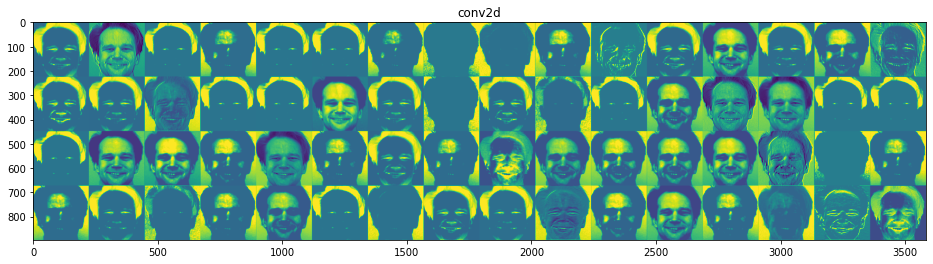

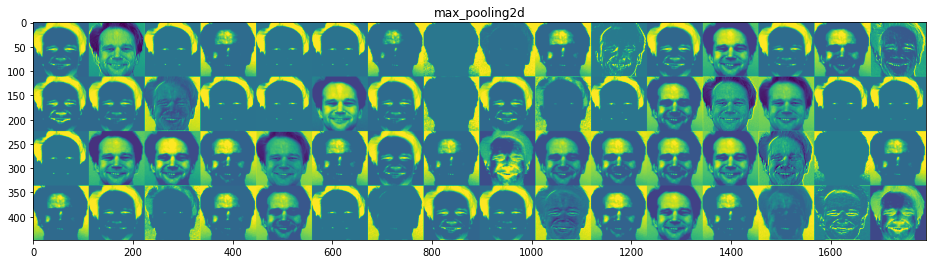

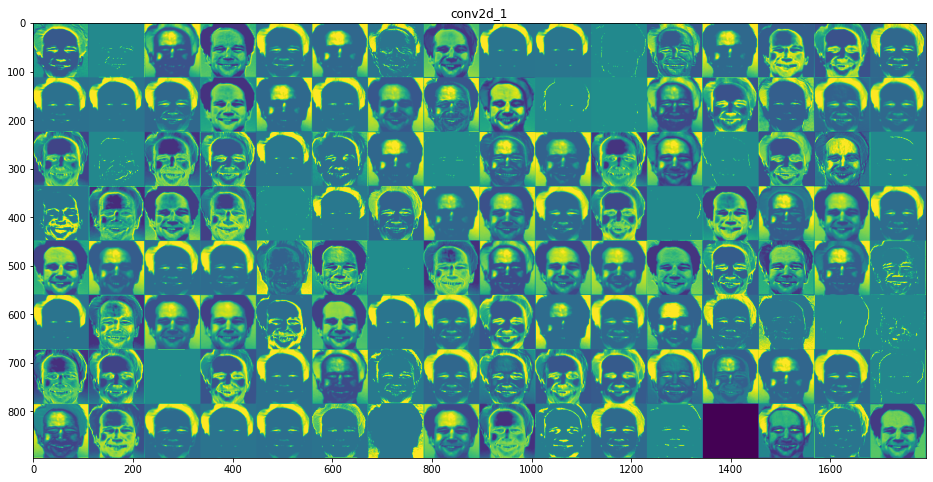

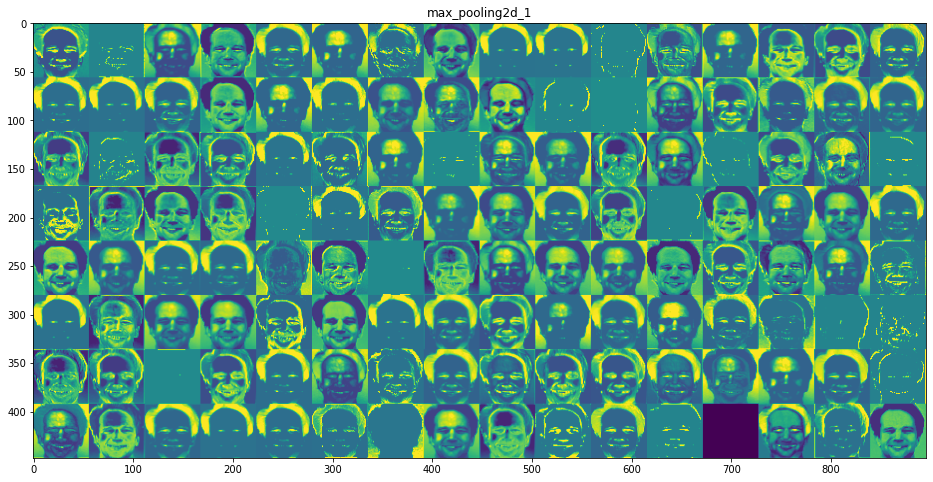

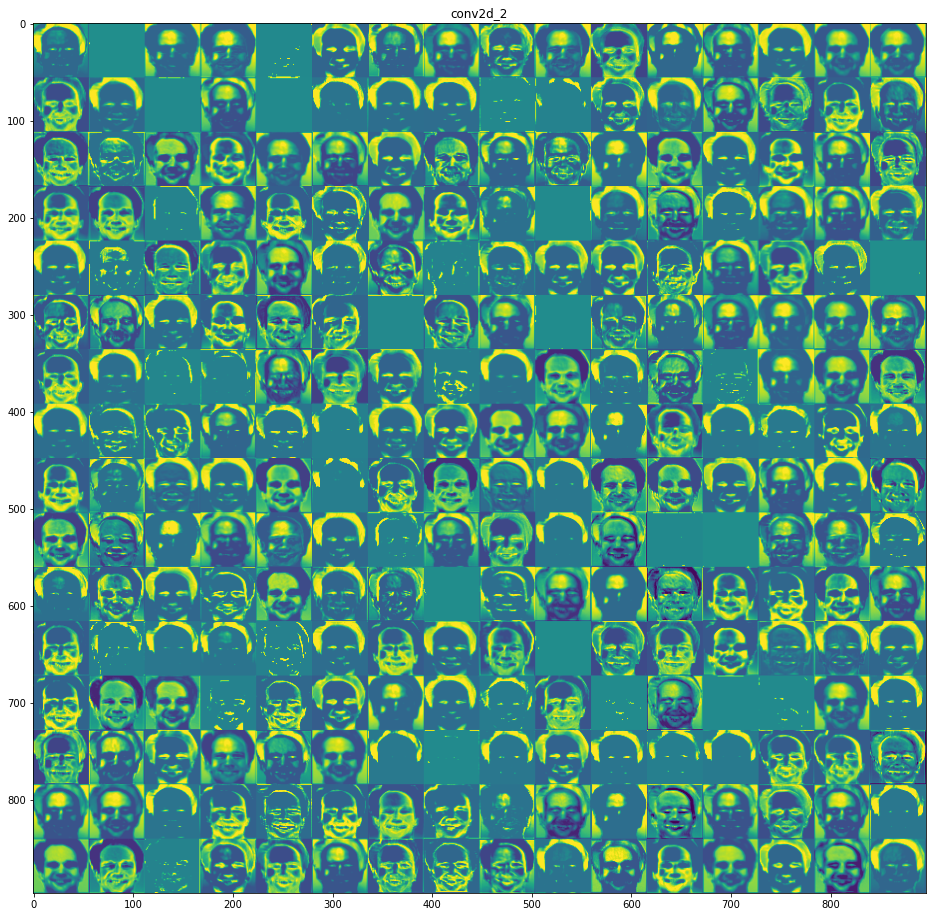

...

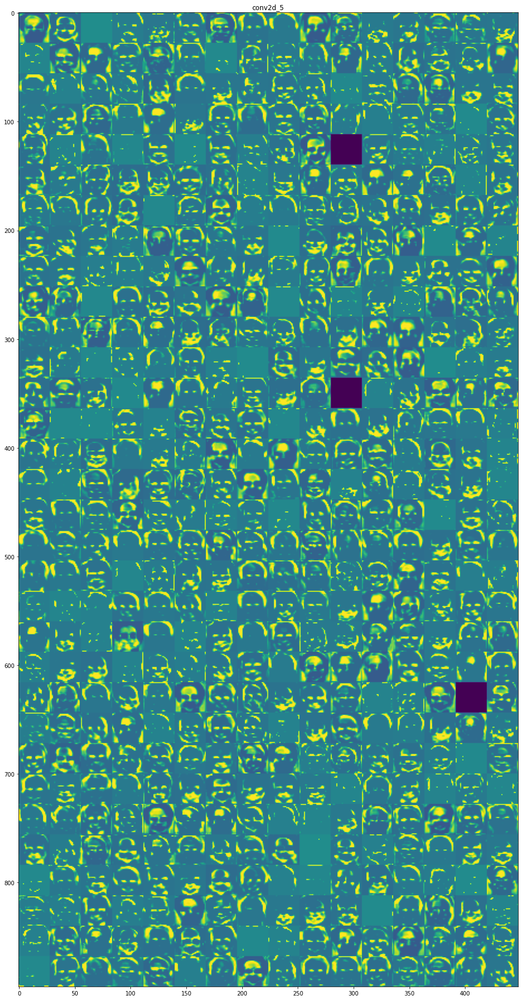

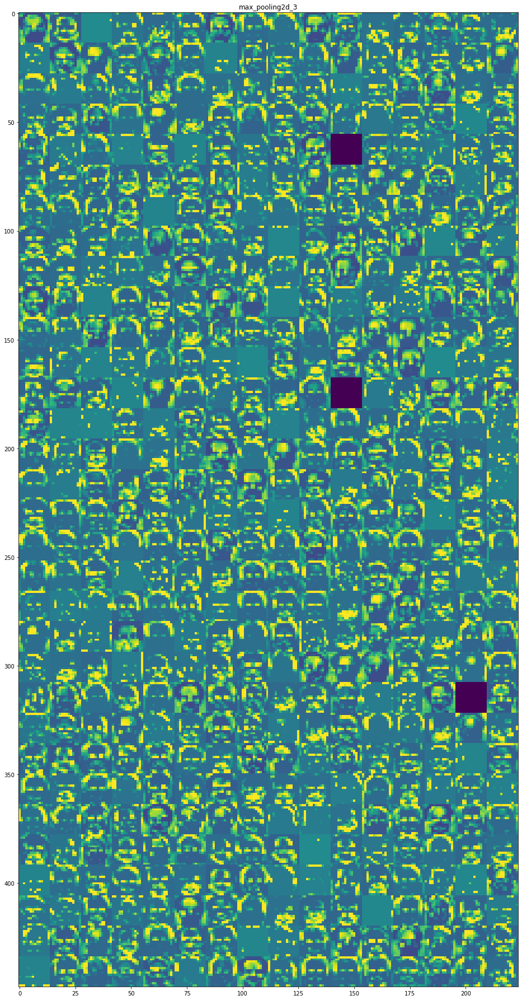

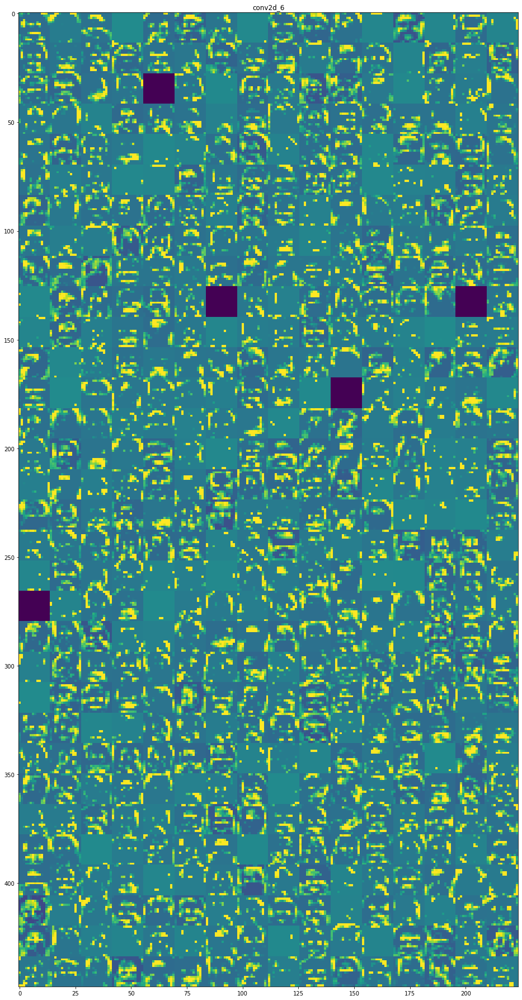

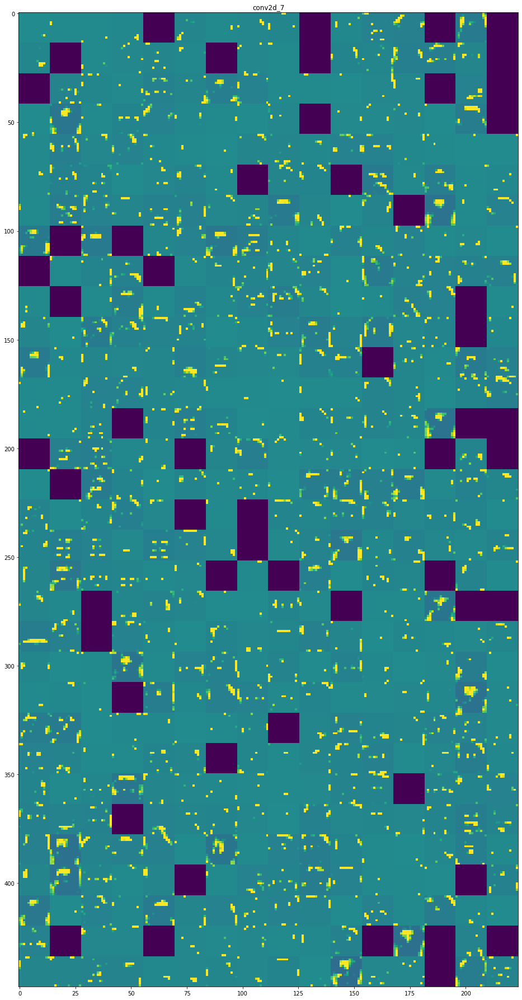

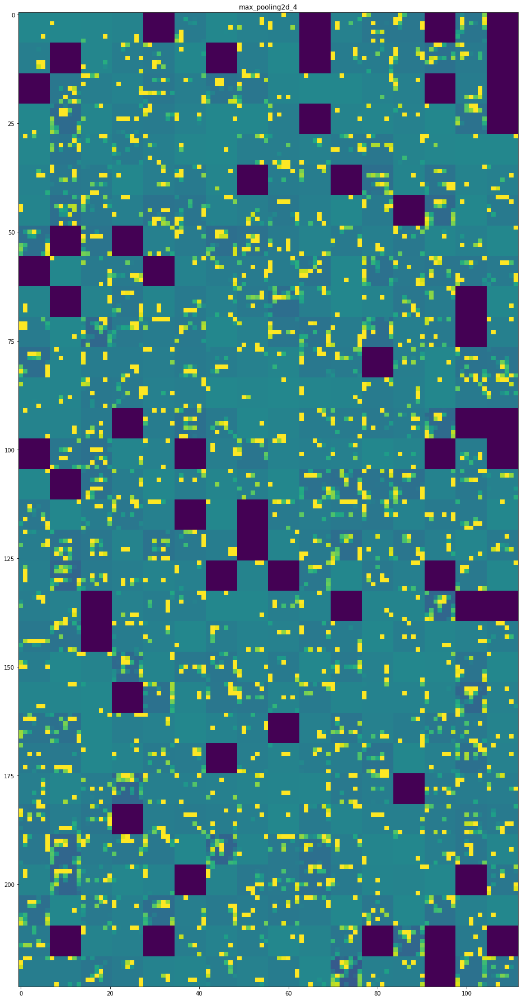

In [12]:
layer_names = dict_SFig2B_SPLIT_Layer_Names_and_Activations["layer_names"]
activations = dict_SFig2B_SPLIT_Layer_Names_and_Activations["activations"]

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:, :,col * images_per_row + row].T  # To transpose axis
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

### Expression Model

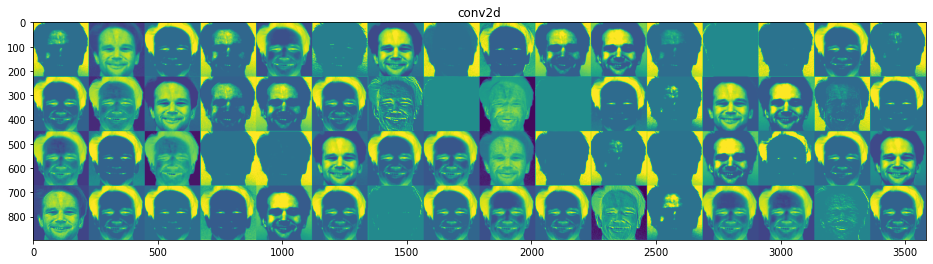

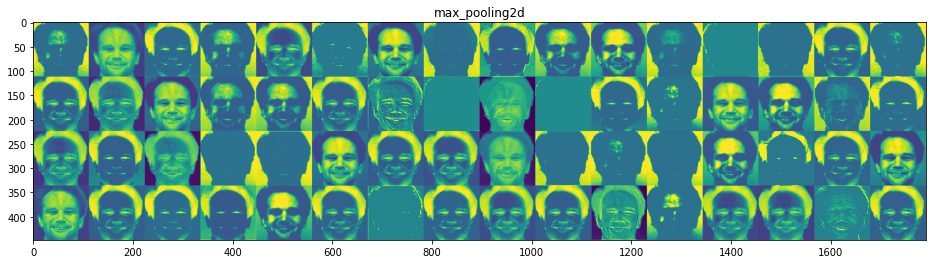

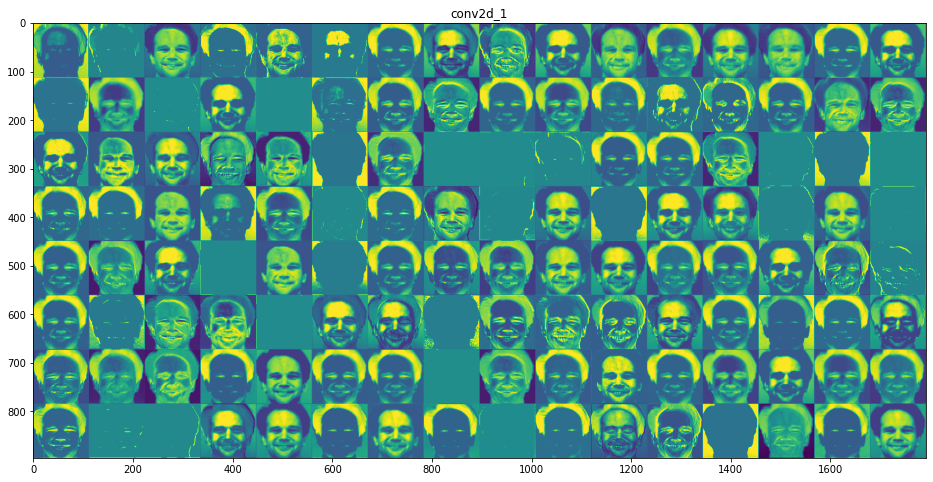

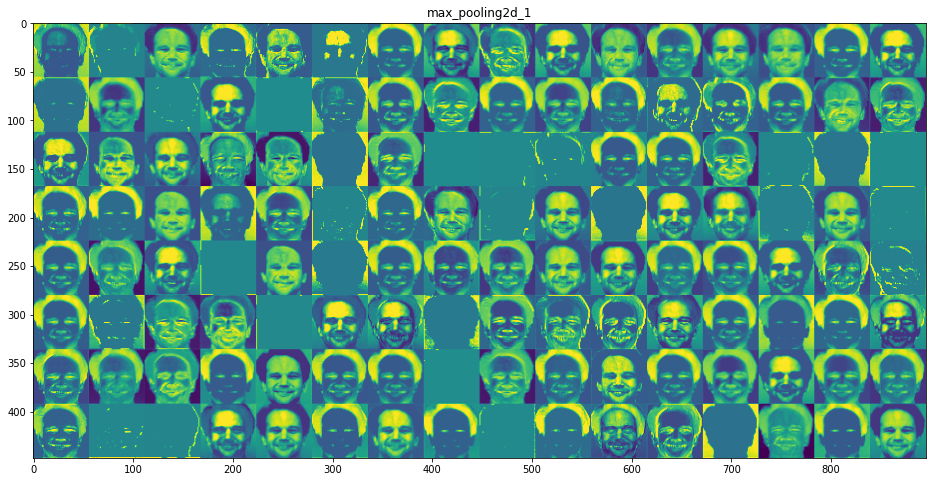

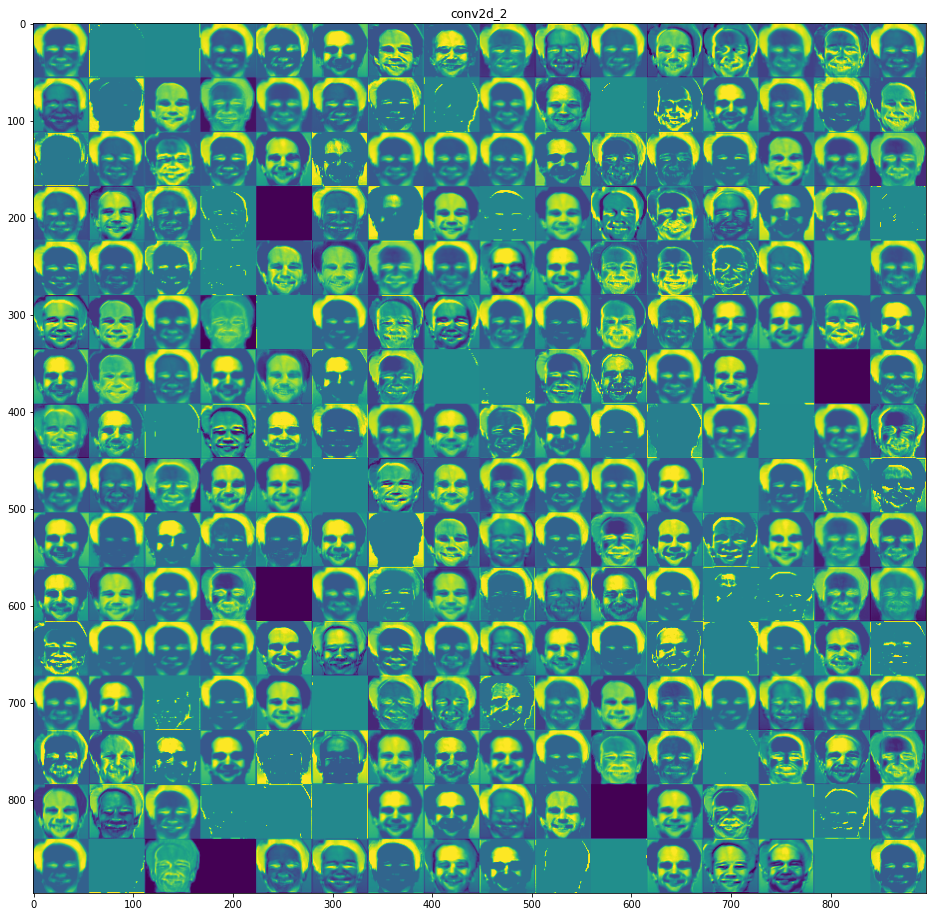

...

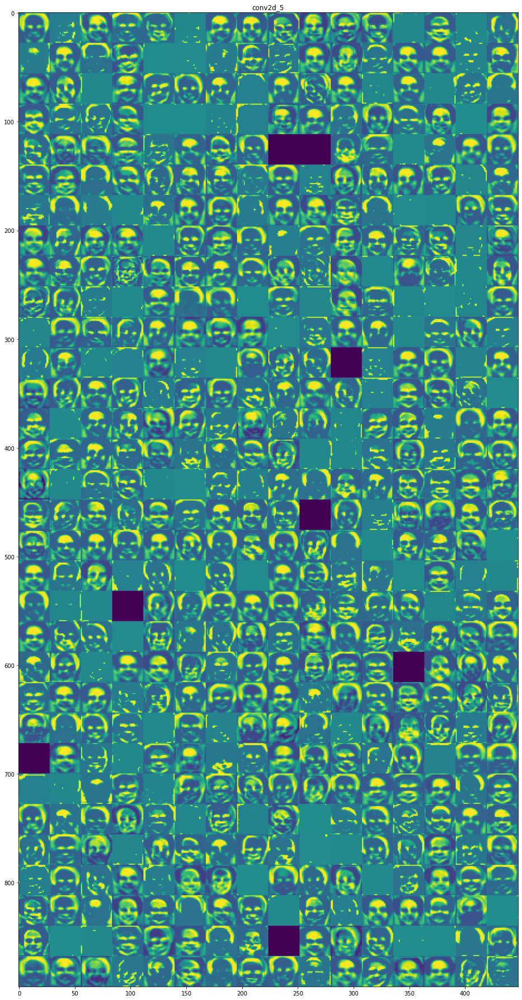

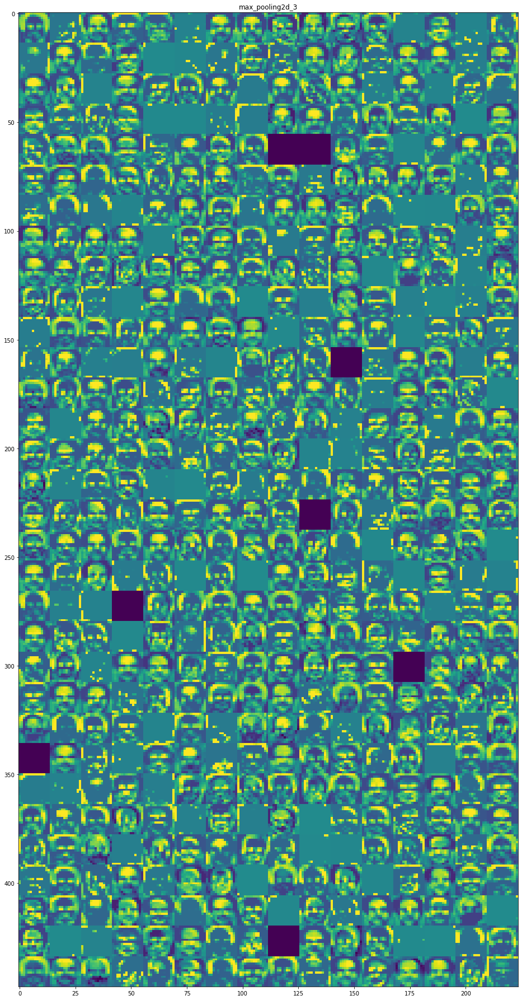

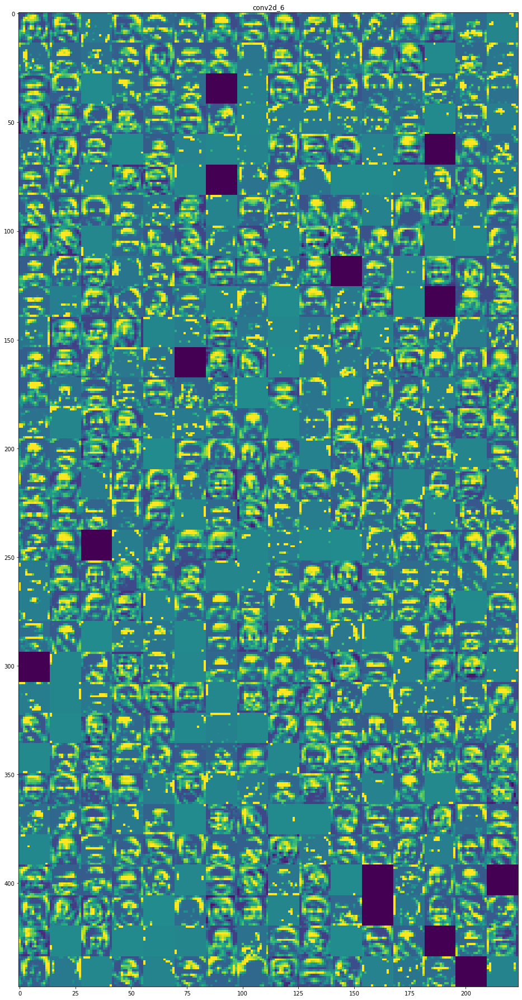

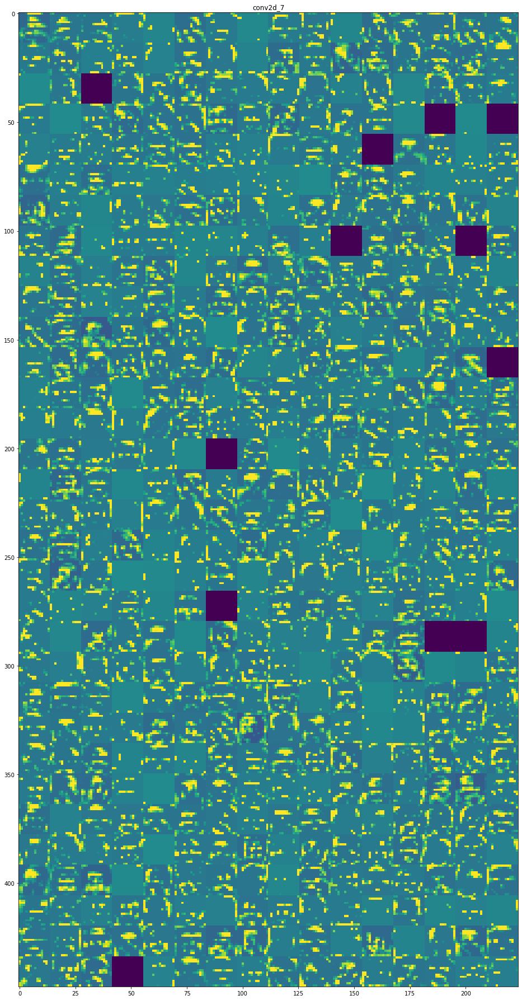

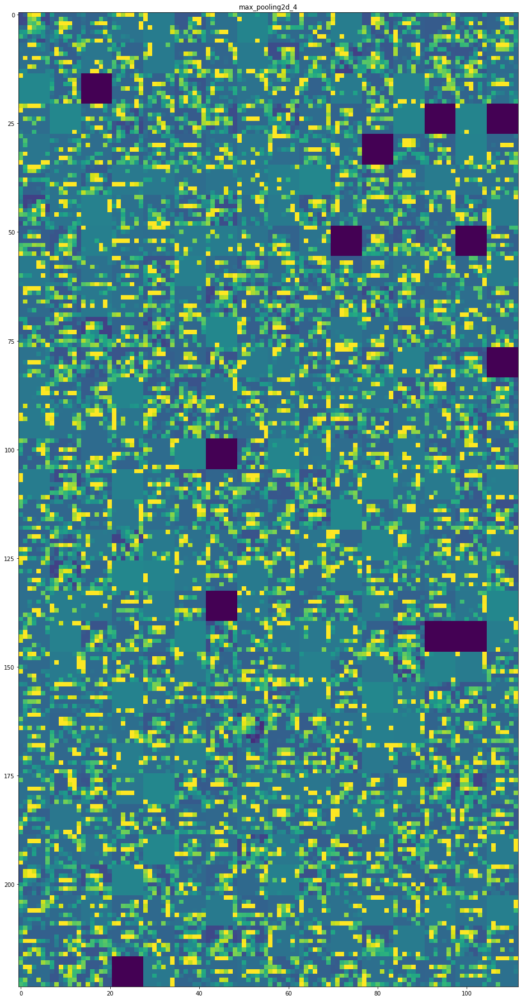

In [13]:
layer_names = dict_SFig2B_exp_Layer_Names_and_Activations["layer_names"]
activations = dict_SFig2B_exp_Layer_Names_and_Activations["activations"]

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:, :,col * images_per_row + row].T  # To transpose axis
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

### Identity Model

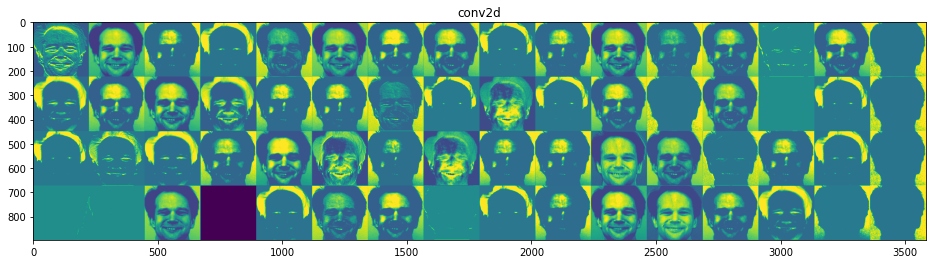

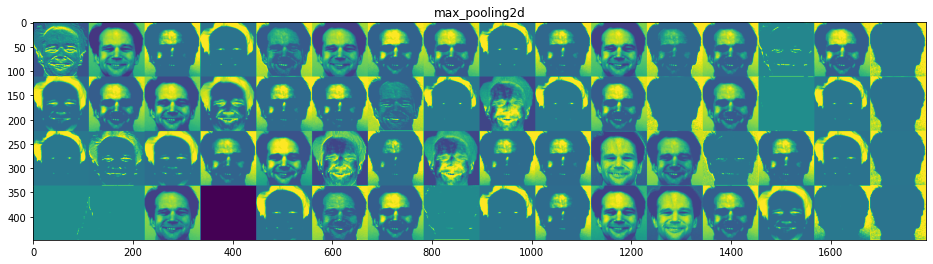

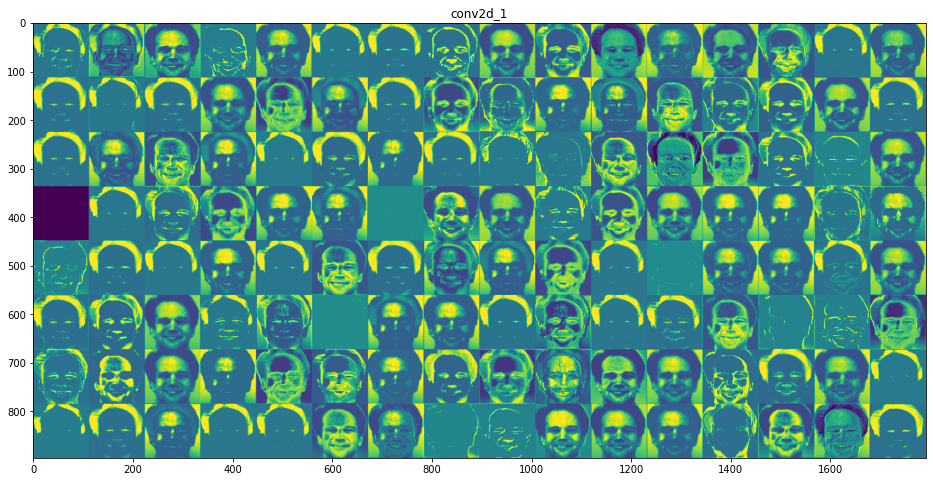

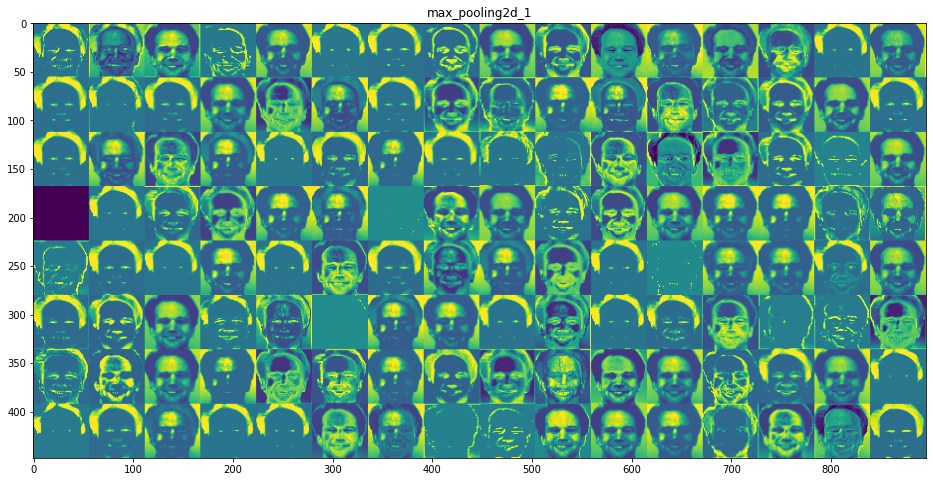

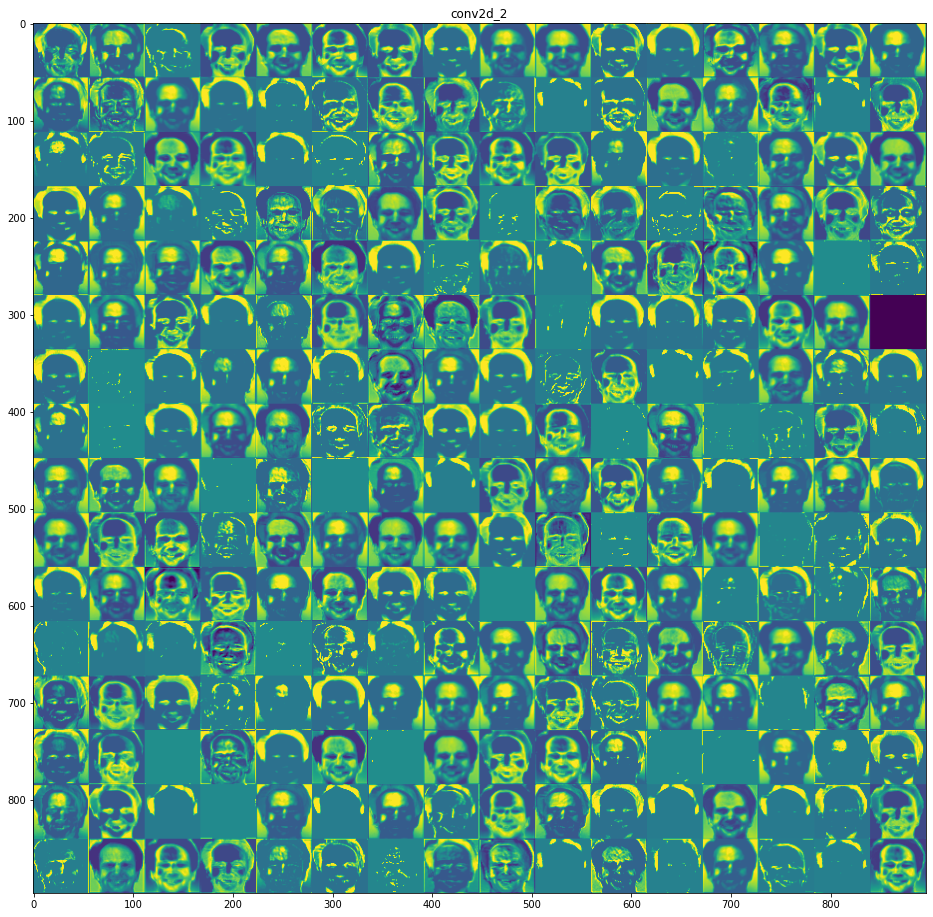

...

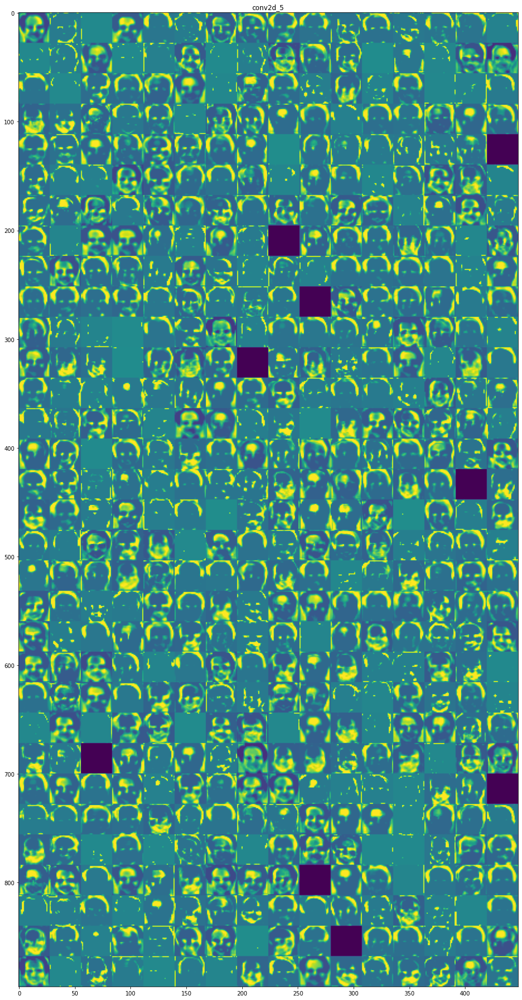

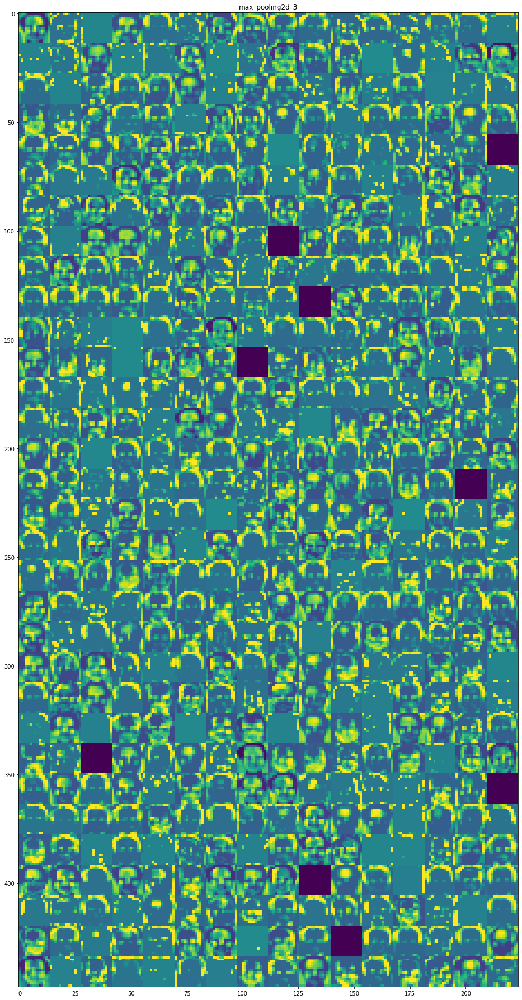

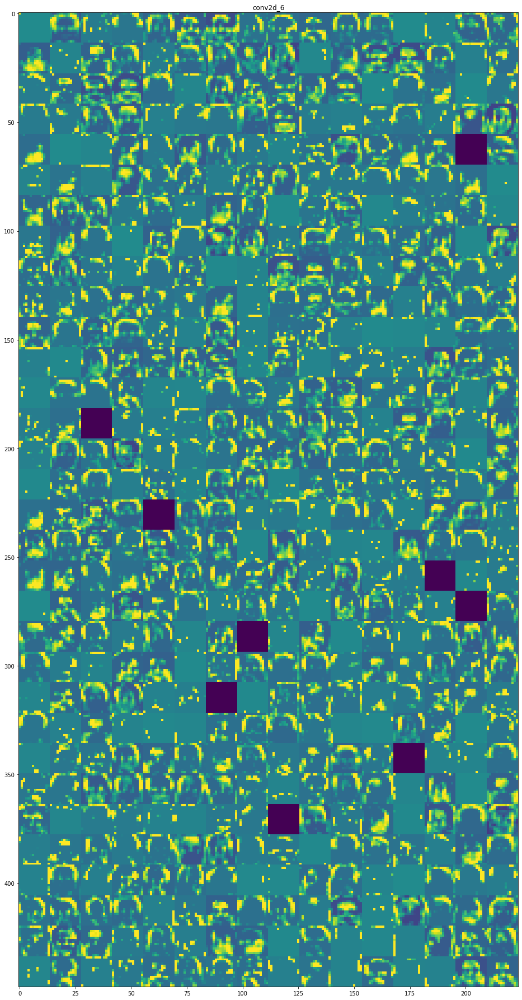

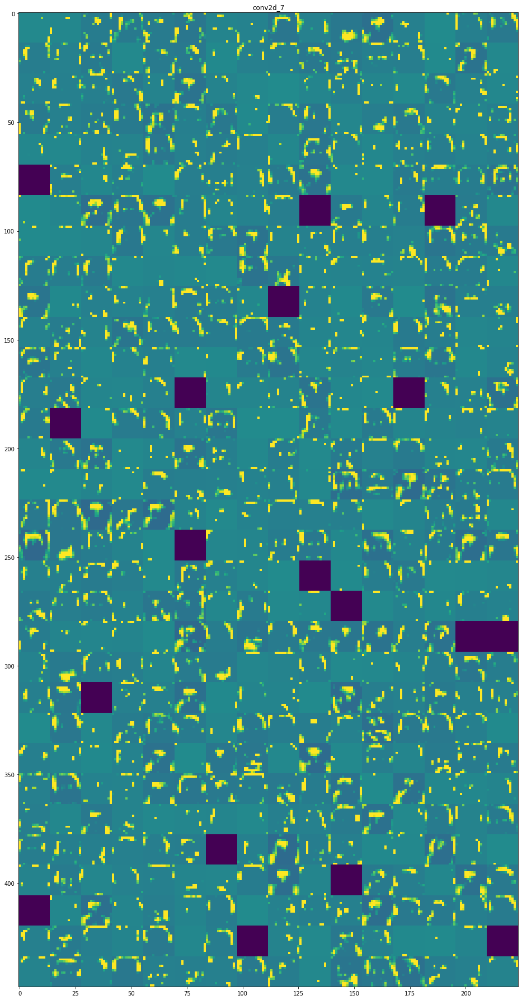

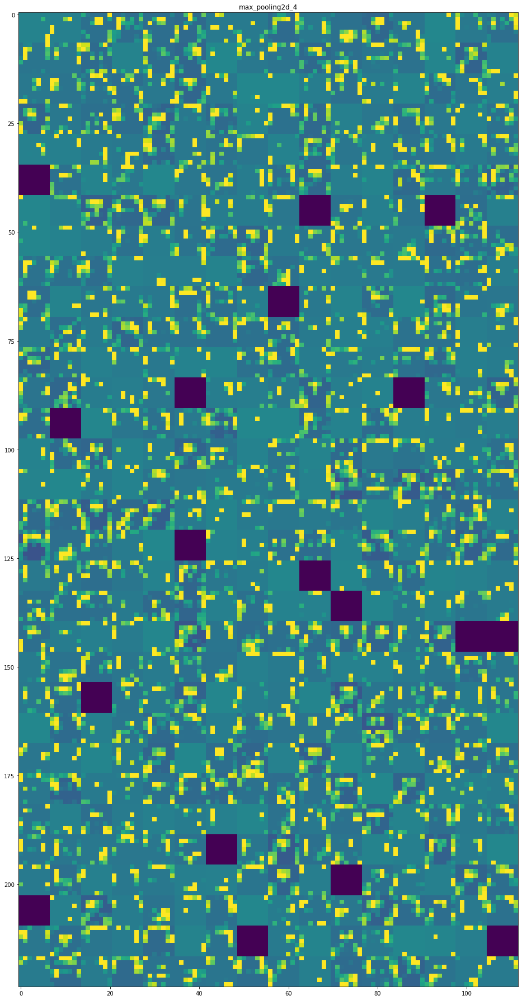

In [14]:
layer_names = dict_SFig2B_id_Layer_Names_and_Activations["layer_names"]
activations = dict_SFig2B_id_Layer_Names_and_Activations["activations"]

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:, :,col * images_per_row + row].T  # To transpose axis
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')